INUWA AMIR USMAN
WIJ220

Train MaskRCNN on my own dataset.
I chose CVAT as my annotation tool and i had 2 labels dog and human, i labelled them manually and then i exported the data as coco.json format which is very popular. then i chose Detectron2 as my rcnn training and evaluator.
i had 25 images for training and 5 for validation.

Detectron2 installation

In [1]:
!python -m pip install pyyaml==5.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-f6cvg7qp
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-f6cvg7qp


IMPORT LIBRARIES

In [3]:
import matplotlib.pyplot as plt
import cv2
import os
import torch, torchvision
import json
import numpy as np
import cv2
import detectron2
import random
from detectron2.utils.logger import setup_logger
from google.colab.patches import cv2_imshow
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data.datasets import register_coco_instances
setup_logger()

<Logger detectron2 (DEBUG)>

LOADING THE DATA

In [4]:
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/maskrcnn/train.json", "/content/drive/MyDrive/maskrcnn/images")
register_coco_instances("my_dataset_val", {}, "/content/drive/MyDrive/maskrcnn/val.json", "/content/drive/MyDrive/maskrcnn/images/valid")

VISUALIZING TO MAKE SURE IT WAS LOADED CORRECTLY FOR DETECTRON

[05/29 18:21:39 d2.data.datasets.coco]: Loaded 25 images in COCO format from /content/drive/MyDrive/maskrcnn/train.json


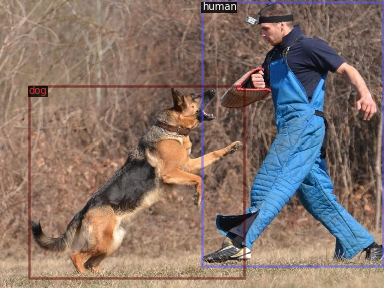

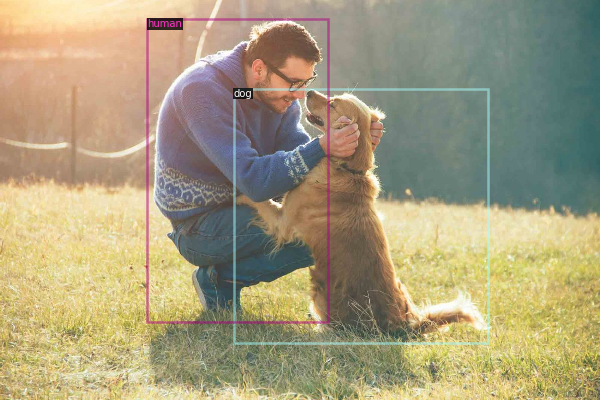

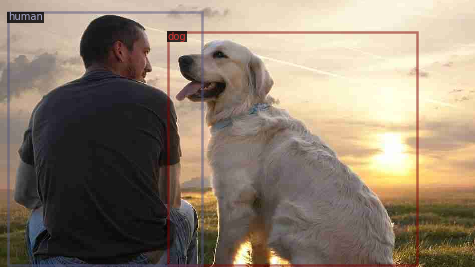

In [5]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])


CONFIGURATION AND TRAINING THE DATA

In [6]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = 300    # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/29 18:21:47 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, we

[05/29 18:21:54 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/29 18:22:26 d2.utils.events]:  eta: 0:07:47  iter: 19  total_loss: 1.345  loss_cls: 0.4904  loss_box_reg: 0.7786  loss_rpn_cls: 0.0004791  loss_rpn_loc: 0.004087  time: 1.5974  data_time: 0.0300  lr: 0.0012854  max_mem: 6048M
[05/29 18:22:57 d2.utils.events]:  eta: 0:07:00  iter: 39  total_loss: 0.6594  loss_cls: 0.1116  loss_box_reg: 0.5539  loss_rpn_cls: 3.355e-05  loss_rpn_loc: 0.006178  time: 1.5681  data_time: 0.0088  lr: 0.0026174  max_mem: 6048M
[05/29 18:23:29 d2.utils.events]:  eta: 0:06:31  iter: 59  total_loss: 0.3054  loss_cls: 0.05458  loss_box_reg: 0.2316  loss_rpn_cls: 1.854e-05  loss_rpn_loc: 0.005581  time: 1.5868  data_time: 0.0074  lr: 0.0039494  max_mem: 6248M
[05/29 18:24:00 d2.utils.events]:  eta: 0:05:50  iter: 79  total_loss: 0.2638  loss_cls: 0.04989  loss_box_reg: 0.208  loss_rpn_cls: 6.969e-05  loss_rpn_loc: 0.004246  time: 1.5731  data_time: 0.0070  lr: 0.0052814  max_mem: 6248M
[05/29 18:24:32 d2.utils.events]:  eta: 0:05:18  iter: 99  total_loss: 0.238

PREDICTION AND VISUALIZATION

[05/29 18:29:53 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,8,3,3)         |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

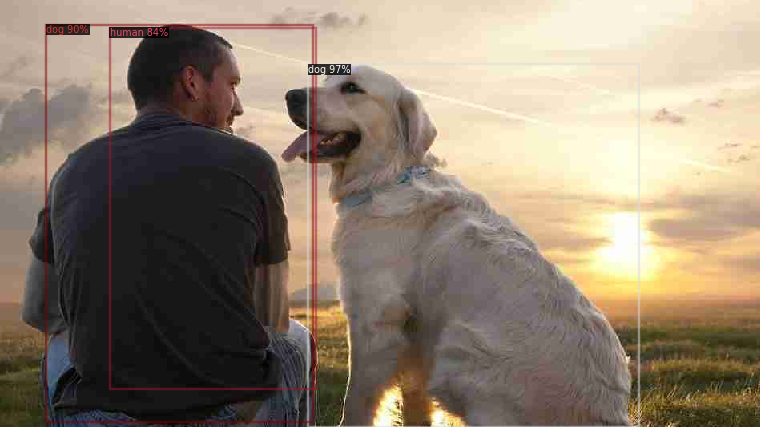

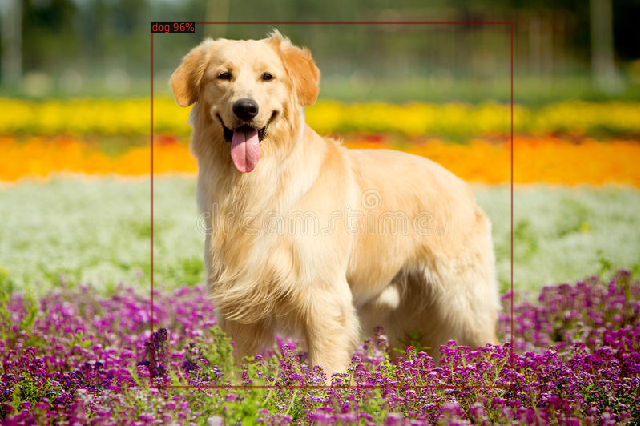

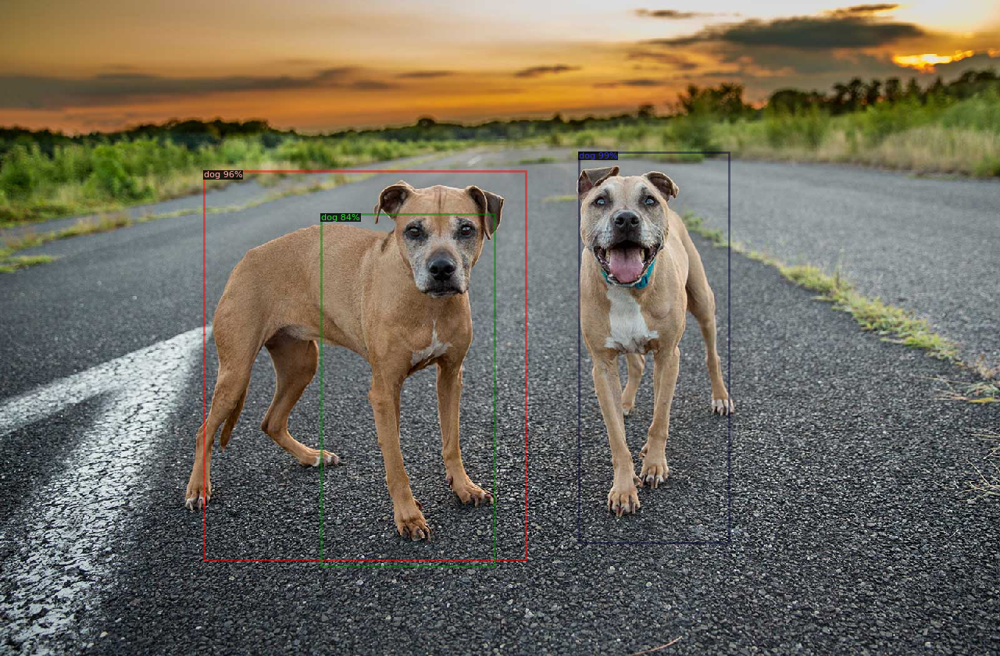

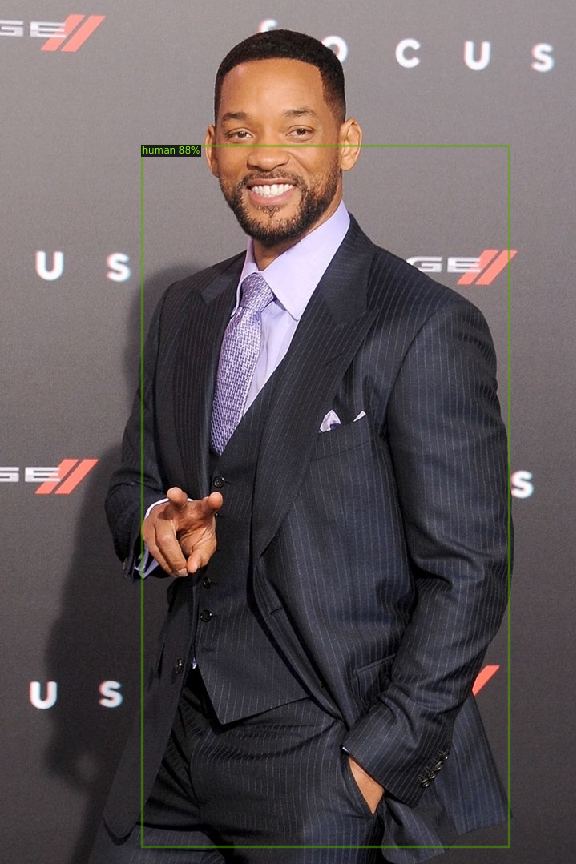

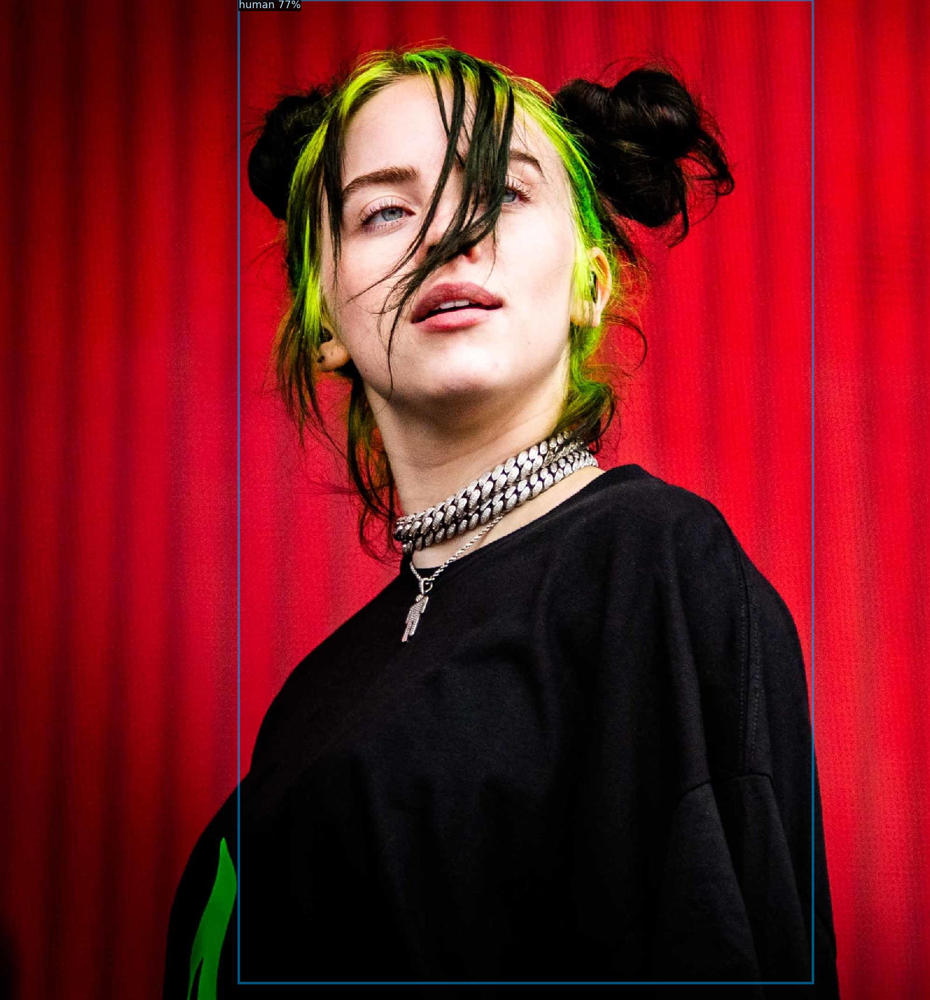

In [8]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_val", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_val")

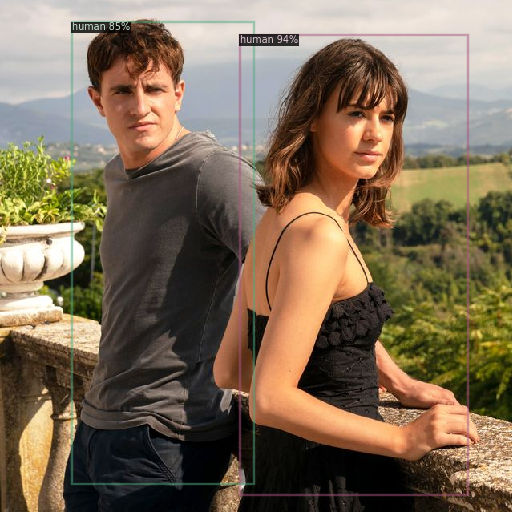

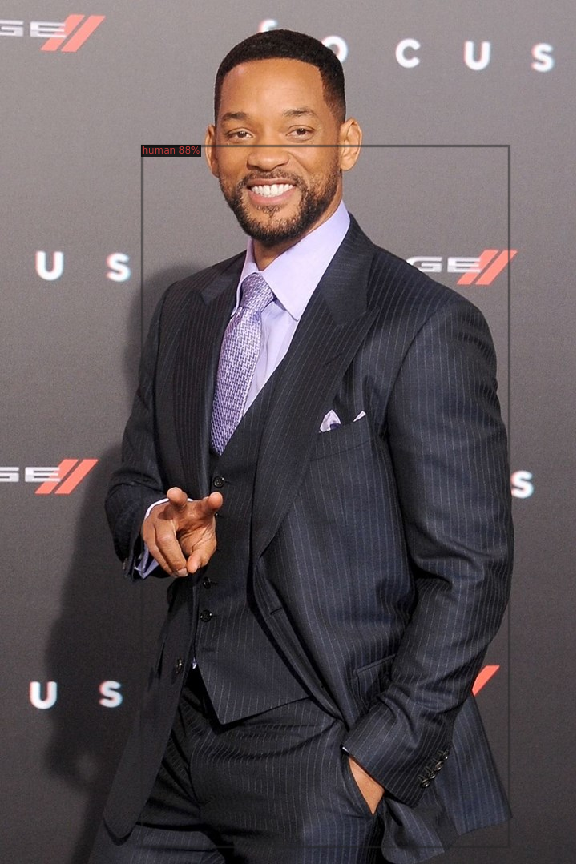

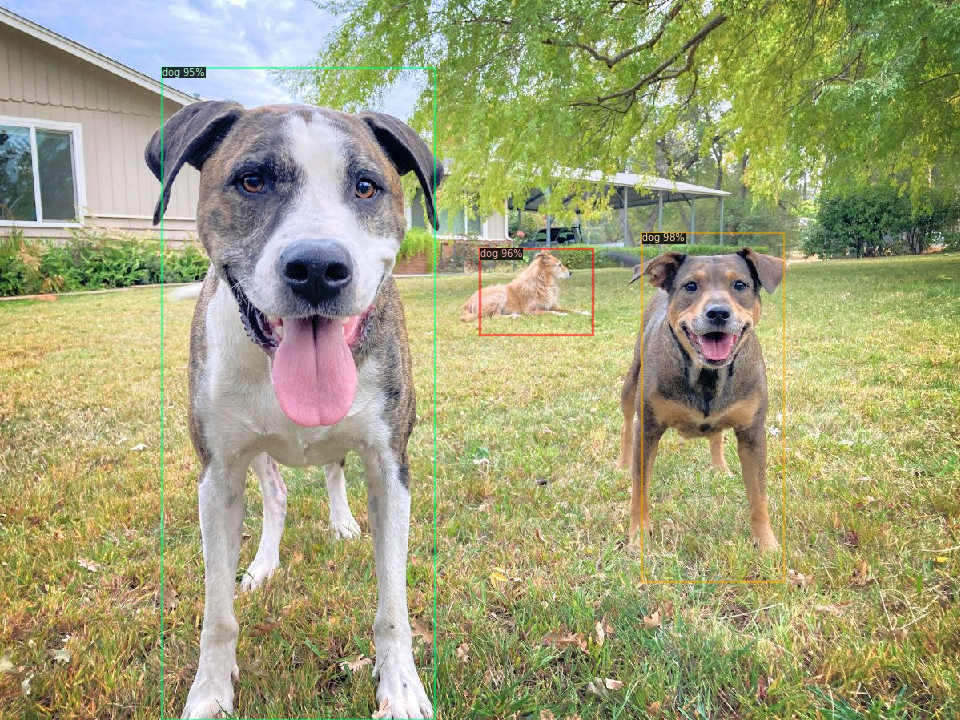

In [18]:
from detectron2.utils.visualizer import ColorMode
import glob

for d in random.sample(dataset_dicts, 3):  
  im = cv2.imread(d["file_name"])
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8,
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

EVALUATING ON THE VALIDATED DATA

In [15]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [21]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "my_dataset_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

[05/29 19:03:02 d2.data.datasets.coco]: Loaded 5 images in COCO format from /content/drive/MyDrive/maskrcnn/val.json
[05/29 19:03:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/29 19:03:02 d2.data.common]: Serializing 5 elements to byte tensors and concatenating them all ...
[05/29 19:03:02 d2.data.common]: Serialized dataset takes 0.00 MiB
[05/29 19:03:02 d2.evaluation.evaluator]: Start inference on 5 batches
[05/29 19:03:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.281334 (0.281334 s / iter per device, on 1 devices)
[05/29 19:03:04 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.204700 s / iter per device, on 1 devices)
[05/29 19:03:04 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/29 19:03:04 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[05/29 19:03:04 d2.e

In [23]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [05/29 19:08:42 d2.checkpoint.c2_model_loading]: Shape of backbone.bottom_up.res2.0.conv1.norm.bias in checkpoint is torch.Size([256]), while shape of backbone.bottom_up.res2.0.conv1.norm.bias in model is torch.Size([64]).
WARNING [05/29 19:08:42 d2.checkpoint.c2_model_loading]: backbone.bottom_up.res2.0.conv1.norm.bias will not be loaded. Please double check and see if this is desired.
WARNING [05/29 19:08:42 d2.checkpoint.c2_model_loading]: Shape of backbone.bottom_up.res2.0.conv1.norm.running_mean in checkpoint is torch.Size([256]), while shape of backbone.bottom_up.res2.0.conv1.norm.running_mean in model is torch.Size([64]).
WARNING [05/29 19:08:42 d2.checkpoint.c2_model_loading]: backbone.bottom_up.res2.0.conv1.norm.running_mean will not be loaded. Please double check and see if this is desired.
WARNING [05/29 19:08:42 d2.checkpoint.c2_model_loading]: Shape of backbone.bottom_up.res2.0.conv1.norm.running_var in checkpoint is torch.Size([256]), while shape of backbone.botto

Skip loading parameter 'backbone.bottom_up.res2.0.conv1.norm.bias' to the model due to incompatible shapes: (256,) in the checkpoint but (64,) in the model! You might want to double check if this is expected.
Skip loading parameter 'backbone.bottom_up.res2.0.conv1.norm.running_mean' to the model due to incompatible shapes: (256,) in the checkpoint but (64,) in the model! You might want to double check if this is expected.
Skip loading parameter 'backbone.bottom_up.res2.0.conv1.norm.running_var' to the model due to incompatible shapes: (256,) in the checkpoint but (64,) in the model! You might want to double check if this is expected.
Skip loading parameter 'backbone.bottom_up.res2.0.conv1.norm.weight' to the model due to incompatible shapes: (256,) in the checkpoint but (64,) in the model! You might want to double check if this is expected.
Skip loading parameter 'backbone.bottom_up.res2.0.conv1.weight' to the model due to incompatible shapes: (256, 64, 1, 1) in the checkpoint but (64,

WARNING [05/29 19:08:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/29 19:08:44 d2.data.datasets.coco]: Loaded 5 images in COCO format from /content/drive/MyDrive/maskrcnn/val.json
[05/29 19:08:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/29 19:08:44 d2.data.common]: Serializing 5 elements to byte tensors and concatenating them all ...
[05/29 19:08:44 d2.data.common]: Serialized dataset takes 0.00 MiB
[05/29 19:08:44 d2.evaluation.evaluator]: Start inference on 5 batches


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[05/29 19:08:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.509688 (0.509688 s / iter per device, on 1 devices)
[05/29 19:08:47 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.231525 s / iter per device, on 1 devices)
[05/29 19:08:47 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/29 19:08:47 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[05/29 19:08:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[05/29 19:08:47 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[05/29 19:08:47 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[05/29 19:08:47 d2.evaluation.fast_eval_api]: Accumulating evaluation results...
[05/29 19:08:47 d2.evaluation.fast_eval_api]: COCOeval_opt.accumulate() finished in 0.01 seconds.
 Average Precision  (AP)

OrderedDict([('bbox',
              {'AP': 51.85808580858085,
               'AP-dog': 68.8118811881188,
               'AP-human': 34.904290429042895,
               'AP50': 87.82178217821782,
               'AP75': 55.61056105610561,
               'APl': 51.85808580858085,
               'APm': nan,
               'APs': nan})])

Playing around with Inference with a panoptic segmentation model

model_final_cafdb1.pkl: 261MB [00:05, 51.7MB/s]                           


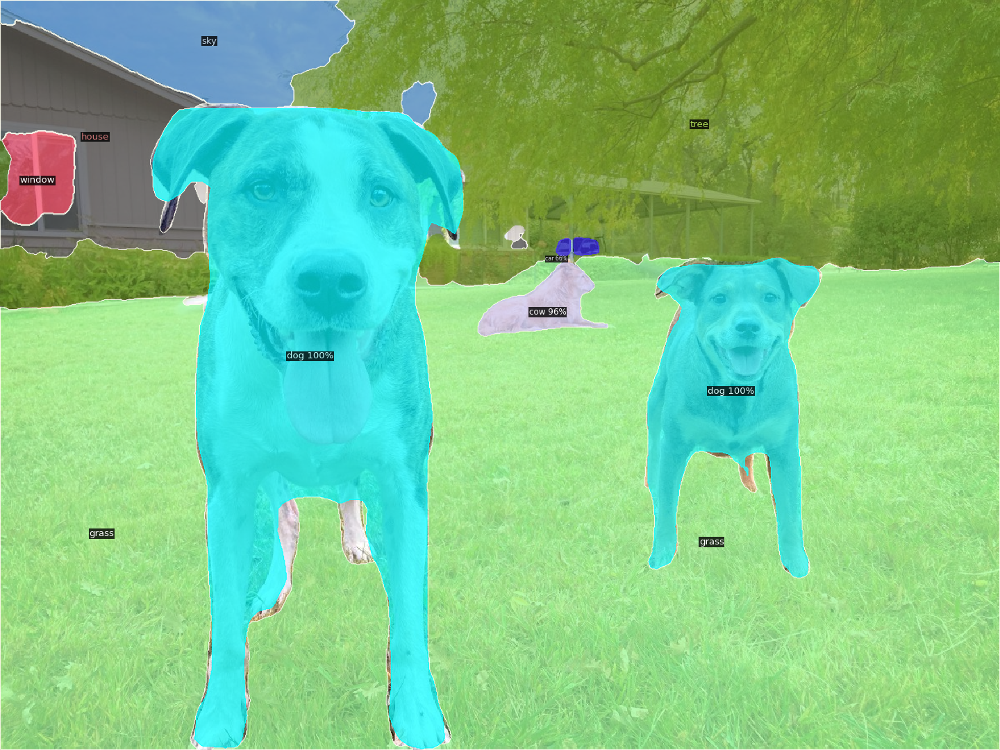

In [22]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
predictor = DefaultPredictor(cfg)
panoptic_seg, segments_info = predictor(im)["panoptic_seg"]
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(out.get_image()[:, :, ::-1])